In [ ]:
import gensim
from gensim import utils
import numpy as np
import sys
from sklearn.datasets import fetch_20newsgroups
from nltk import word_tokenize
from nltk import download
from nltk.corpus import stopwords
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
%matplotlib inline

In [ ]:
!wget https://zenodo.org/record/1199620/files/SO_vectors_200.bin?download=1

--2021-08-11 03:29:54--  https://zenodo.org/record/1199620/files/SO_vectors_200.bin?download=1
Resolving zenodo.org (zenodo.org)... 137.138.76.77
Connecting to zenodo.org (zenodo.org)|137.138.76.77|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1453905423 (1.4G) [application/octet-stream]
Saving to: ‘SO_vectors_200.bin?download=1’

SO_vectors_200.bin? 100%[===================>]   1.35G  21.3MB/s    in 33s     

2021-08-11 03:30:27 (42.4 MB/s) - ‘SO_vectors_200.bin?download=1’ saved [1453905423/1453905423]



In [ ]:
model = gensim.models.KeyedVectors.load_word2vec_format(
    '/content/SO_vectors_200.bin?download=1', binary=True
    )

In [ ]:
download('punkt') #tokenizer, run once
download('stopwords') #stopwords dictionary, run once
stop_words = stopwords.words('english')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
def preprocess(text):
    text = text.lower()
    doc = word_tokenize(text)
    doc = [word for word in doc if word not in stop_words]
    #doc = [word for word in doc if word.isalpha()] #restricts string to alphabetic characters only
    return doc

In [ ]:
import pandas as pd

In [ ]:
train_df = pd.read_csv('https://raw.githubusercontent.com/giturra/TopicVisualization/clean_data/data/clean_train_data.csv')

In [ ]:
title = list(train_df['Title'])
body = list(train_df['Body'])
train_df['full_text'] = [f"{title[i]} {body[i]}" for i in range(len(title))]

In [ ]:
sentences = list(train_df['full_text'])

In [ ]:
corpus = [preprocess(sentence) for sentence in sentences]

In [ ]:
def document_vector(word2vec_model, doc):
    # remove out-of-vocabulary words
    doc = [word for word in doc if word in word2vec_model.vocab]
    return np.mean(word2vec_model[doc], axis=0)

In [ ]:
def has_vector_representation(word2vec_model, doc):
    """check if at least one word of the document is in the
    word2vec dictionary"""
    return not all(word not in word2vec_model.vocab for word in doc)

In [ ]:
X =[]
for doc in corpus: #look up each doc in model
    X.append(document_vector(model, doc))

In [ ]:
X[0]

array([ 1.2051687 , -0.33428666, -0.9113171 ,  1.3576232 , -1.1529851 ,
        0.52813077,  0.49286902,  0.16663134, -0.90939087, -0.08226019,
       -0.08714397,  0.04708853, -0.3058451 , -0.45332953, -0.6819996 ,
        1.1978282 , -0.5819183 , -0.9838431 , -0.6692481 , -0.60168654,
       -0.81408304, -0.54081565, -0.5528191 ,  0.4117276 ,  0.9918609 ,
       -0.6728735 , -0.6844473 , -0.55596733,  0.6386169 , -0.23444465,
       -0.21312854,  0.01356861, -0.5260109 , -0.3579878 , -1.0610594 ,
        0.39995152, -0.6516775 , -0.57629365,  0.3061764 ,  0.06327357,
        0.10104995,  0.528211  , -0.34311754, -0.74890393,  0.04436016,
        0.03816921, -0.62827337,  0.96363616,  0.49543253,  0.018949  ,
        1.5159625 , -0.23678707, -1.3095887 ,  0.02759927, -0.3557899 ,
       -0.07604609, -0.7145311 ,  0.6398899 ,  0.35799503,  0.32456067,
        0.6674142 , -1.1080515 ,  0.11847541,  0.3783319 ,  0.1251183 ,
       -1.7740954 ,  0.704893  ,  0.38367411, -0.25212783,  0.00

In [ ]:
pca = PCA(n_components=2)
x_pca = pca.fit_transform(X)

In [ ]:
len(X[1])


200

In [ ]:
np.save('word_embedding.npy', X)

In [ ]:
from nltk.cluster import KMeansClusterer
import nltk
import numpy as np 
  
from sklearn import cluster
from sklearn import metrics

In [ ]:
NUM_CLUSTERS=2
kclusterer = KMeansClusterer(NUM_CLUSTERS, distance=nltk.cluster.util.cosine_distance, repeats=25)
assigned_clusters = kclusterer.cluster(X, assign_clusters=True)
print (assigned_clusters)

[0, 0, 1, 0, 1, 0, 0, 1, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 1, 0, 

In [ ]:
for index, sentence in enumerate(sentences):    
    print (str(assigned_clusters[index]) + ":" + str(sentence))

Se truncaron las últimas líneas 5000 del resultado de transmisión.
0:Initialize map with pair of std::arrays c++11 i would like to compile this lines insert to map pair of std arrays 
1:Can't enable phar writing i am actually using wamp 2 5 with php 5 5 12 and when i try to create a phar file it returns me the following message uncaught exception unexpectedvalueexception with message creating archive disabled by the php ini setting phar readonly even if i turn to off the phar readonly option in php ini so how can i enable the creation of phar files 
0:Which is the most difficult to reverse the order of the sort (largest to smallest) from Insertions sort selection sort or merge sort? i know that the answer to the question is that they are all equally difficult to reverse but i dont know why could someone explain this 
0:How to remove "My Wish List" and "Compare Products" blocks from Magento 2.0 Luma template? i have spent a lot of hours trying to remove my wish list and compare products

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Se truncaron las últimas líneas 5000 del resultado de transmisión.
1:save aws glacier downloaded file to amazon s3 location i am creating a php apis using glacier php sdk for initiating and downloading and i have successfully downloaded file in my local server now i want to save downloaded archive file from glacier to s3 location i have done some research and didnt find any possible way please help thanks 
1:Visual Studio 2015 Diagnostic Tools Window doesn't show up im able to show the diagnostic tools windows via debug > windows > show diagnostic tool but that windows always disappears when starting / debugging the application what is going on 
1:BottomNavigationView - How to get selected menu item? i used bottomnavigationview to switch fragments how to get currently selected menu item to prevent reopening fragment 
0:Ruby implementation array#flatten i need to implement ruby array#flatten this implementation remove all the nested arrays a = [ 1 2 [3 [4 5] ] ] def my_flatten arr arr r

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Se truncaron las últimas líneas 5000 del resultado de transmisión.
0:How to return from python function this is my first programming practice i have a python function like this it does not return anything why 
1:Synchronise Dygraph and DateRangeInput in Shiny i would like to synchronise a dygraph and a daterangeinput inside a shiny app the code bellow works fine i can simultaneously use the zoom option and the daterange but i cant use the dyrangeselector because of a ping pong effect any idea how to control that there is no update function for dygraph 
0:Checking for duplicate strings in JavaScript array i have js array with strings for example i need to compare for duplicate strings inside array and if duplicate string exists there should be alert box pointing to that string i was trying to compare it with loop but i dont know how to write code so that array checks it`s own strings for duplicates without already pre determined string to compare 
0:Simple code help needed for " http://

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0:how to add 2 column with respect of group i want to add column a and b separately sum a and sum b with respect of group sampn output 
1:How to fix 'character map file `UTF-8' not found' im setting up a ubi rhel8 container i need to execute this command 
0:why main function isn't returning any value? /*i am trying to return the 1st bit of boolean value of 10 using right shift in the cb function */ ```#include #include bool cb int n int i { //`called function` return n>>i &1 ==1; } int main void { //`main function` cb 10 1 ; //`function calling` return 0; } ``` //status successfully executed but no output 
1:docker for mac memory usage in com.docker.hyperkit im running docker desktop community 2 1 0 3 on macos mojave ive got 8gb of memory allocated to docker which already seems like a lot thats half my ram somehow even after exiting and then starting docker for mac again which means no containers are running docker is already exceeding the memory allocation by 1gb what is expected memo

In [ ]:
kmeans = cluster.KMeans(n_clusters=NUM_CLUSTERS)
kmeans.fit(X)
  
labels = kmeans.labels_
centroids = kmeans.cluster_centers_

Se truncaron las últimas líneas 5000 del resultado de transmisión.
1 Get process memory on Windows i have a library in ruby that shells out to get memory usage of the current process i just received a report that it doesnt work on windows on mac and linux i can shell out to to get the rss memory for process with a pid of 3432 is there an equivalent command in windows 
0 How to filter multiple words in Android Studio logcat i want to see just a couple of words in logcat in other words just a given tags i tried to enable regex and type as filter but it doesnt work 
1 How do I compile a GitHub project? ive tried for few hours and failed i cant seem to get it to work in netbeans ive added libraries that creator pointed out source and nbproject i get errors can someone tell me what to do step by step thank you in advance link to github ive tried adding it i downloaded the zip from github then i created new project in netbeams selected as just java then i went to files tab and dragged and dr

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0 pandas: find percentile stats of a given column i have a pandas data frame my_df where i can find the mean median mode of a given column i am wondering is it possible to find more detailed stats such as 90 percentile thanks 
0 Export const arrow function or basic function? which is better to do export a arrow function like so or export a regular function like so it looks like using the const/arrow function combination declares an extra variable which seems to be an unnecessary extra step over the simple function declaration 
1 Angular 2 Set focus on first field of form on component load in my app i want to automatically set focus on first field of form on component load can anyone please guide how to achieve this without any repetition as i want this on every form reactive forms in my app 
0 pandas - Merging on string columns not working (bug?) im trying to do a simple merge between two dataframes these come from two different sql tables where the joining keys are strings i try to me

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Se truncaron las últimas líneas 5000 del resultado de transmisión.
0 ByteArrayOutputStream - get bytes from string how can i get similar result this code dont compile
0 When Memory is Allocated to Class in C++?  class sample { int a b; public int sum { return a+b ; } }; int main { sample sm; } i am beginner to c++ so please provide keep language of your answer simple so that i understand well thanks in advance 
1 HTML doctype, how browser performs on reading doctype actually i was thinking how browser performs or knows when it reads an specific doctype and after reading doctype is there a pattern present or build in the browser or it searches on internet to know how to display 
0 Matching lines in a text-file with a starting identifer so im a bit stumped on this im reading a file with two types of lines that contain data and they are started by a number followed by a comma i need a way in order to match the lines with the same starting digit into a single line and output that how would

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Se truncaron las últimas líneas 5000 del resultado de transmisión.
0 If condition not working inside a callback function if i write like so things work where did i erred i am expecting that when i click on the player1 button the callback function is called by hnouring the if conditions
0 Pragmatically creating UIView Mask i have a uiview which has a user selected number of circles 5 and a gradient color scheme top image that part was easy the circles are just additional subviews of the master uiview with black borders and the master uiview has a red border how can one create the cyan blue mask seen on the bottom image with code thanks in advance 
1 How to launch an ec2 in particular VPC in Yaml template of CloudFormation can you please answer my question i am just stucked at this how to launch am ec2 in particular subnet of particular vpc using yaml template in cloud formation 
0 BillingClient always returns SERVICE_DISCONNECTED so i have a billing client which i instantiate with for w

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



0 How to match strings of the form "exclude=1" using regular expression? i want to use a regular expression to match strings of the form where the number should be in the range of 1 to 15 ive tried but it does not work thank you 
1 The Angular Compiler requires TypeScript >=3.4.0 and <3.5.0 but 3.5.3 was found instead im getting the following error when i do npm run build the angular compiler requires typescript >=3 4 0 and <3 5 0 but 3 5 3 was found instead ive tried following things separately npm install typescript@ >=3 4 0 <3 5 0 then deleted node_modules and package json run npm install npm update force then deleted node_modules and package json run npm install im still getting the error my package json contains following dependencies what could be going wrong here 
1 Why do Django developers use Django builtin admin panel? is it said that must to use instead of a html theme? i want to develop full functional web application in python django i want to use bootstrap admin theme to 

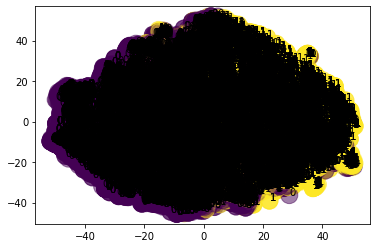

In [ ]:
print ("Cluster id labels for inputted data")
print (labels)
print ("Centroids data")
print (centroids)
  
print ("Score (Opposite of the value of X on the K-means objective which is Sum of distances of samples to their closest cluster center):")
print (kmeans.score(X))
  
silhouette_score = metrics.silhouette_score(X, labels, metric='euclidean')
  
print ("Silhouette_score: ")
print (silhouette_score)
 
 
import matplotlib.pyplot as plt
 
from sklearn.manifold import TSNE
 
model = TSNE(n_components=2, random_state=0)
np.set_printoptions(suppress=True)
 
Y=model.fit_transform(X)
 
 
plt.scatter(Y[:, 0], Y[:, 1], c=assigned_clusters, s=290,alpha=.5)
 
 
for j in range(len(sentences)):    
   plt.annotate(assigned_clusters[j],xy=(Y[j][0], Y[j][1]),xytext=(0,0),textcoords='offset points')
   print ("%s %s" % (assigned_clusters[j],  sentences[j]))
 
 
plt.show()